In [1]:
import geopandas as gpd
import numpy as np
norway = gpd.read_file(r"C:/Users/Raul/Desktop/TFM/Norway_shapefile/gadm41_NOR_0.shp").to_crs("EPSG:4326")  # or the CRS of your climate maps


In [2]:
import xarray as xr
import rioxarray

def clip_to_norway(nc_path, norway_gdf):
    ds = xr.open_dataset(nc_path,engine='netcdf4')
    var_name = list(ds.data_vars.keys())[-1]
    
    # Convert to DataArray and set spatial dims for rioxarray
    da = ds[var_name]
    da.rio.set_spatial_dims(x_dim="lon", y_dim="lat", inplace=True)
    da.rio.write_crs("EPSG:4326", inplace=True)

    # Clip to Norway
    clipped = da.rio.clip(norway_gdf.geometry.values, norway_gdf.crs, drop=True)
    
    return clipped


In [5]:
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"
# variables =['gdd5', 'prsd', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] 
variables =['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] 
scenario = 'rcp85'
file_paths = [f"/data/Future/HIRHAM5/{scenario}/2061-2080/CHELSA_HIRHAM5_{scenario}_{var}_2061-2080_V.1.0" for var in variables]
file_paths.append(path_altitude)


In [7]:
import xarray as xr

# Initialize a dictionary to store climate cubes for each year
climate_cubes_by_year = {}
# years = ['2061-2080']
years = ['2021-2040']
for year in years:
    # Create file paths for CHELSA variables + altitude
    file_paths = {var: f"../data/Future/HIRHAM5/{scenario}/{year}/CHELSA_HIRHAM5_{scenario}_{var}_{year}_V.1.0.nc" for var in variables}
    file_paths["altitude"] = path_altitude  # Add altitude

    # Clip and align all variables
    clipped_layers = {var: clip_to_norway(fp, norway) for var, fp in file_paths.items()}
    aligned_layers = xr.align(*clipped_layers.values(), join="override")

    # Create a dictionary of aligned DataArrays
    dataset_dict = {
        var: layer for var, layer in zip(clipped_layers.keys(), aligned_layers)
    }

    # Combine into a Dataset
    norway_climate_dataset = xr.Dataset(dataset_dict)

    # Save to NetCDF
    output_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{scenario}_{year}.nc"
    norway_climate_dataset.to_netcdf(output_path)

    # Store in memory if needed
    climate_cubes_by_year[year] = norway_climate_dataset
    print(f"Saved climate cube for {year}")




C:\Users\Raul\AppData\Local\Temp\ipykernel_4280\530474486.py:5: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  ds = xr.open_dataset(nc_path,engine='netcdf4')
C:\Users\Raul\AppData\Local\Temp\ipykernel_4280\530474486.py:5: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates prior reform date (1582-10-15). To silence this warning specify 'use_cftime=True'.
  ds = xr.open_dataset(nc_path,engine='netcdf4')


Saved climate cube for 2021-2040


### Loading climatic maps

Variables in dataset: ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'altitude']


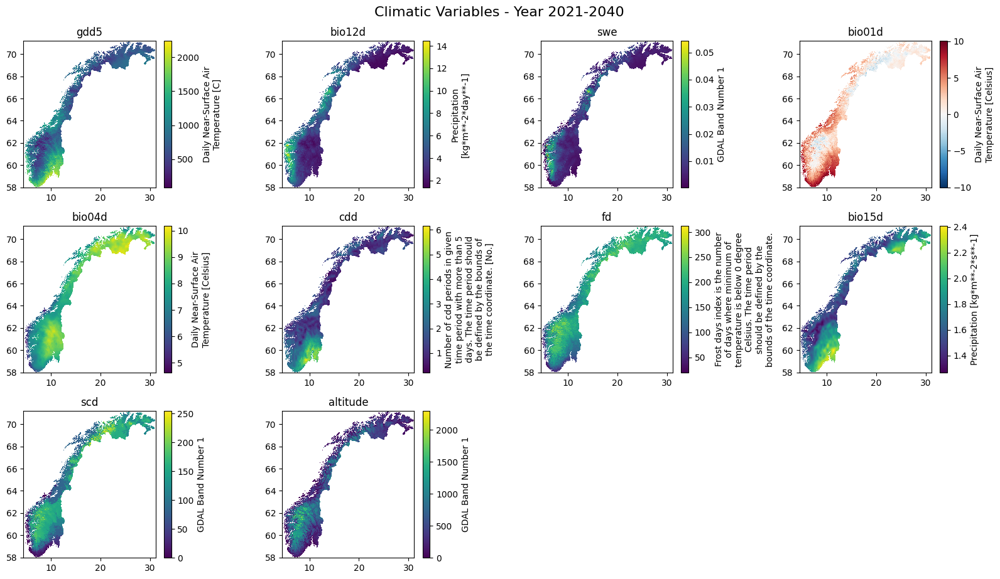

In [9]:
import xarray as xr
import matplotlib.pyplot as plt
# year = '2061-2080'
year = '2021-2040'

def climatic_map_loading(year):
    # Load the dataset
    file_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{scenario}_{year}.nc"
    ds = xr.open_dataset(file_path)
    
    # List all variable names
    variables = list(ds.data_vars)[1:]
    print("Variables in dataset:", variables)
    
    # Set up subplot grid (e.g., 3 rows x 4 cols for 11 vars)
    n_vars = len(variables)
    n_cols = 4
    n_rows = (n_vars + n_cols - 1) // n_cols  # ceiling division
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 3 * n_rows))
    axes = axes.flatten()
    
    # Plot each variable
    for i, var in enumerate(variables):
        data = ds[var]
        
        # If time dimension exists, take the first time step
        if "time" in data.dims:
            data = data.isel(time=0)
            
        data.plot(ax=axes[i], add_colorbar=True)
        axes[i].set_title(var)
        axes[i].set_xlabel("")
        axes[i].set_ylabel("")
    
    # Turn off any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")
    
    plt.tight_layout()
    plt.suptitle(f"Climatic Variables - Year {year}", fontsize=16, y=1.02)
    plt.show()
climatic_map_loading(year)


### Extracting absolute max/min values

In [10]:
import xarray as xr
import numpy as np
import os

# Folder where NetCDF files are stored
folder = "C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\"
# years = ['2061-2080']

# Dictionary to store global min/max per variable
global_min = {}
global_max = {}

# Loop through each year
for year in years:
    file_path = os.path.join(folder, f"climate_cube_{scenario}_{year}.nc")
    ds = xr.open_dataset(file_path)

    for var in ds.data_vars:
        data = ds[var]
        
        # Compute min and max for this file
        var_min = float(data.min().values)
        var_max = float(data.max().values)

        # Update global min and max
        if var not in global_min:
            global_min[var] = var_min
            global_max[var] = var_max
        else:
            global_min[var] = min(global_min[var], var_min)
            global_max[var] = max(global_max[var], var_max)

# Print global min/max
for var in global_min:
    print(f"{var}: min = {global_min[var]:.4f}, max = {global_max[var]:.4f}")


crs: min = 0.0000, max = 0.0000
gdd5: min = 80.5453, max = 2239.4277
bio12d: min = 1.3628, max = 14.4339
swe: min = 0.0002, max = 0.0542
bio01d: min = -5.7381, max = 10.0519
bio04d: min = 4.6223, max = 10.1738
cdd: min = 0.2000, max = 6.1500
fd: min = 19.2000, max = 312.2000
bio15d: min = 1.2655, max = 2.4079
scd: min = 0.0000, max = 254.0000
altitude: min = 0.0000, max = 2296.0000


In [11]:
import pandas as pd

# Ensure the year suffix is stripped properly
df_stats['Variable'] = df_stats['Variable'].str.replace(r'_\d{4}', '', regex=True)

# Debugging: Check 'Variable' after stripping the year suffix
print("\nAfter stripping year suffix:")
print(df_stats.head())  # Check the first few rows again

# Group by variable name and find the absolute min and max across all years
absolute_stats = df_stats.groupby('Variable').agg({'Min': 'min', 'Max': 'max'}).reset_index()

# Show the result
print("\nAbsolute min/max per variable:")
absolute_stats


NameError: name 'df_stats' is not defined

In [21]:
# absolute_stats.to_csv(r'C:\Users\Raul\Desktop\TFM\Data\absolute_stats_2020.csv',index = False)


### Creating Patches

In [34]:
import pandas as pd

In [35]:
file_name = r'C:\Users\Raul\Desktop\TFM\Data\assemblages_aggregated_by_grid_with_centroids.csv'
gbif_assemblages_1991_2020 = pd.read_csv(file_name)

# Filter the gbif_assemblages DataFrame for years <= 2018
# gbif_assemblages = gbif_assemblages_1991_2020[gbif_assemblages_1991_2020['year'] <= 2018]

gbif_assemblages = gbif_assemblages_1991_2020

gbif_assemblages


,grid_index,year,species,longitude,latitude
0,79228,2020,"['Lonicera periclymenum', 'Tripolium pannonicu...",5.180633,59.174643
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189
...,...,...,...,...,...
71741,1818627,2017,"['Luzula spicata', 'Antennaria dioica', 'Cochl...",30.835603,69.774990
71742,1820117,1994,"['Honckenya peploides', 'Alnus incana', 'Epilo...",30.847255,69.755439
71743,1821608,1994,"['Taraxacum spectabile', 'Astragalus norvegicu...",30.865522,69.744514
71744,1823096,2019,"['Lysimachia europaea', 'Chamaenerion angustif...",30.863871,69.707711


In [36]:
year = '2011'
file_path = f"C:\\Users\\Raul\\Desktop\\TFM\\CHELSA\\climate_cubes\\climate_cube_{year}.nc"
ds = xr.open_dataset(file_path)

# Get variable list and process each one
variables = list(ds.data_vars)[1:]  # Skip first if needed
print(variables)
stacked = []
print(ds)

['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd', 'altitude']
<xarray.Dataset> Size: 203MB
Dimensions:      (time: 1, lon: 3198, lat: 1587)
Coordinates:
  * time         (time) datetime64[ns] 8B 2011-07-02
  * lon          (lon) float64 26kB 4.512 4.521 4.529 ... 31.14 31.15 31.15
  * lat          (lat) float64 13kB 57.96 57.97 57.98 ... 71.16 71.17 71.18
    spatial_ref  int32 4B ...
Data variables:
    crs          int32 4B ...
    gdd5         (time, lat, lon) float32 20MB ...
    bio12d       (time, lat, lon) float32 20MB ...
    swe          (lat, lon) float32 20MB ...
    bio01d       (time, lat, lon) float32 20MB ...
    bio04d       (time, lat, lon) float32 20MB ...
    cdd          (time, lat, lon) float32 20MB ...
    fd           (time, lat, lon) float32 20MB ...
    bio15d       (time, lat, lon) float32 20MB ...
    scd          (lat, lon) float32 20MB ...
    altitude     (lat, lon) float32 20MB ...


In [37]:
# Load the NetCDF file
def read_netcdf(file_path,latitude,longitude,grid,location):
    data = xr.open_dataset(file_path)
    # data = xr.open_dataset(file_path)
    # Step 1: Find the indices of the closest grid point
    lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
    lon_idx = np.argmin(np.abs(data['lon'].values - longitude))
    
    # Step 2: Select all months of the year
    #precipitation= data.sel(**{"time": slice(1, 12)})

    # Extract variable name (it is always the last variable)
    variable = list(data.data_vars.keys())[-1]
    print(variable)
    # Step 3: Extract a 10x10 grid centered around Bergen
    patch = data[variable].isel(
        lat=slice(lat_idx - grid, lat_idx + grid),
        lon=slice(lon_idx - grid, lon_idx + grid)
    )
    
    # Step 4: Calculate the mean precipitation across all months
    #mean_patch = patch.mean(dim="time")
    
    # Step 5: Plot with Cartopy for map context
    plt.figure(figsize=(10, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())  # PlateCarree assumes latitude/longitude
    
    # Plot the precipitation data
    # mean_patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    patch.plot(ax=ax, cmap="Blues", transform=ccrs.PlateCarree(), add_colorbar=True)
    
    # Add map features
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='black')  # Country borders
    ax.add_feature(cfeature.COASTLINE, edgecolor='black')               # Coastline
    # ax.set_extent([mean_patch.lon.min(), mean_patch.lon.max(), mean_patch.lat.min(), mean_patch.lat.max()])
    ax.set_extent([patch.lon.min(), patch.lon.max(), patch.lat.min(), patch.lat.max()])

    
    # Add city marker for Bergen
    plt.scatter(longitude, latitude, color="red", label=location, transform=ccrs.PlateCarree())
    plt.legend()
    
    # Title and labels
    plt.title(f"{variable} in {location}, (10x10 grid)")
    plt.show()

    return patch

frost_days_index_per_time_period


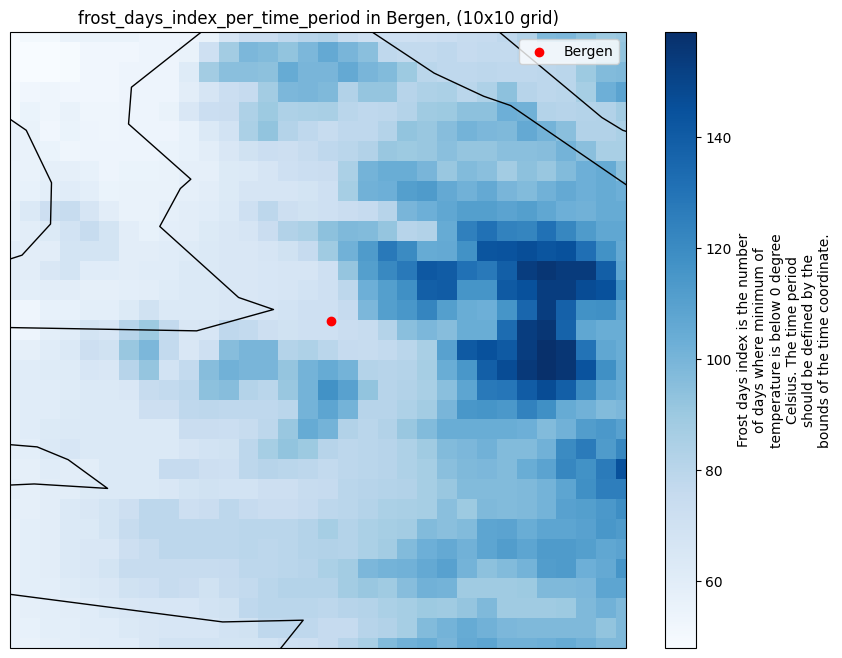

pr


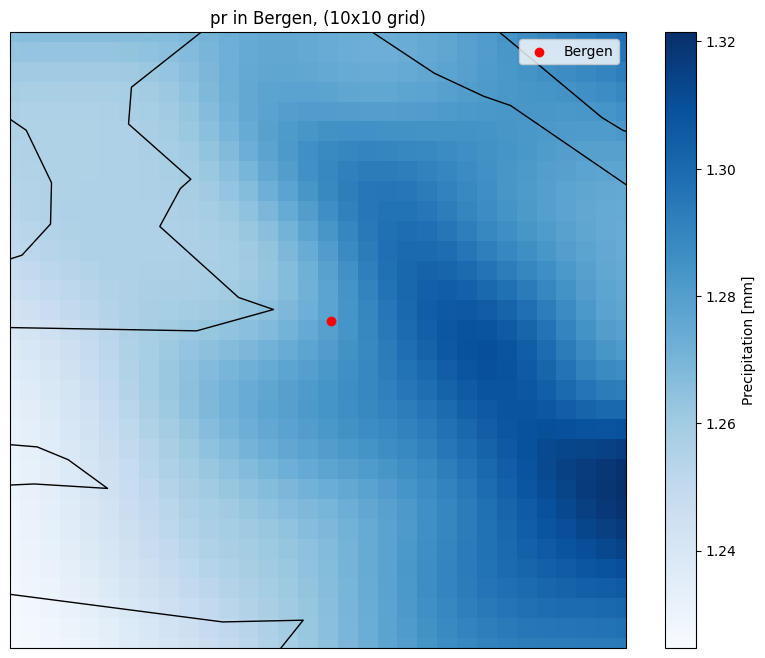

In [38]:
import cartopy.feature as cfeature  # Import the cfeature module
import cartopy.crs as ccrs

path_fd = r"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/fd/CHELSA_EUR11_obs_fd_2011_V.2.1.nc"
path_bio15d = r"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio15d/CHELSA_EUR11_obs_bio15d_2000_V.2.1.nc"

fd = read_netcdf(file_path = path_fd, #path_prsd,
            latitude = 60.3913,
            longitude = 5.3221,
            # variable = 'pr',
            grid = 16,
            location = 'Bergen')
bio15d = read_netcdf(file_path = path_bio15d,#path_prsd,
            latitude = 60.3913,
            longitude = 5.3221,
            # variable = 'pr',
            grid = 16,
            location = 'Bergen')

As we can see there are many NA values so we might stick to the original preprocessing pipeline

In [39]:
def read_netcdf_stack(file_paths, latitude, longitude, grid):
    patches = []
    # scaler = MinMaxScaler(feature_range=(0, 1))  # Define the scaler

    for file_path in file_paths:
        data = xr.open_dataset(file_path)
        variable = list(data.data_vars.keys())[-1]

        lat_idx = np.argmin(np.abs(data['lat'].values - latitude))
        lon_idx = np.argmin(np.abs(data['lon'].values - longitude))

        patch = data[variable].isel(
            lat=slice(lat_idx - grid, lat_idx + grid),
            lon=slice(lon_idx - grid, lon_idx + grid)
        ).fillna(0).values  # Convert to NumPy

        print(f"Shape of patch for {file_path} {variable}: {patch.shape}")

        # Remove extra dimension if necessary
        if patch.shape[0] == 1:
            patch = patch[0]

        # # Reshape for MinMax scaling (flatten to 2D)
        # patch_reshaped = patch.reshape(-1, 1)  # Flatten but keep 1 feature

        # # Apply MinMax Scaling
        # patch_scaled = scaler.fit_transform(patch_reshaped)

        # # Reshape back to original (grid*2, grid*2)
        # patch_scaled = patch_scaled.reshape(patch.shape)

        # patches.append(patch_scaled)  # Add scaled patch
        
        patches.append(patch)  # Add NOT scaled patch


    # Stack along last axis (channels dimension)
    stacked_patches = np.stack(patches, axis=-1)

    return stacked_patches

In [40]:

# Example Usage:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables = ['gdd5', 'bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd']
file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_2000_V.2.1.nc" for var in variables]
file_paths.append(path_altitude)
latitude = 62.9,
longitude = 8.2,
grid_size = 16 # 10x10 grid bc we substract 5 from lat and 5 from lon

# Call the function to get the stacked patches
stacked_patches = read_netcdf_stack(file_paths, latitude, longitude, grid_size)

# Now stacked_patches is a 3D numpy array with shape (10, 10, 10), representing a 10x10 grid with 10 channels

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/prsd/CHELSA_EUR11_obs_prsd_2000_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2000_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2000_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2000_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual

In [ ]:
# Define the file paths for each variable (you need to have the full paths for each variable)
path_altitude = r"C:\Users\Raul\Desktop\TFM\CHELSA\DEM\dem_latlong.nc"

variables =['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd'] # 'prsd', we have removed it bc its WRONG

stacked_patches_list = []
# x = 100
for i in range(gbif_assemblages.shape[0]): # gbif_assemblages.shape[0]
    sample =  gbif_assemblages.iloc[i]
    file_paths = [f"C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/{var}/CHELSA_EUR11_obs_{var}_{sample.year}_V.2.1.nc" for var in variables]
    file_paths.append(path_altitude)
    
    # Call the function to get the stacked patches
    stacked_patches = read_netcdf_stack(file_paths = file_paths, 
                                        latitude = sample.latitude, 
                                        longitude = sample.longitude, 
                                        grid = 16) # better to use multiples of 64
    
    stacked_patches_list.append(stacked_patches)

    print(f'Sample {i} correctly stacked and added to the list')
    print('\n\n')

Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/gdd5/CHELSA_EUR11_obs_gdd5_2020_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio12d/CHELSA_EUR11_obs_bio12d_2020_V.2.1.nc pr: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/swe/CHELSA_EUR11_obs_swe_2020_V.2.1.nc Band1: (32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio01d/CHELSA_EUR11_obs_bio01d_2020_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/bio04d/CHELSA_EUR11_obs_bio04d_2020_V.2.1.nc tas: (1, 32, 32)
Shape of patch for C:/Users/Raul/Desktop/TFM/CHELSA/1991-2020/chelsav2/EUR11/obs/annual/V2.1/cdd/CHELSA_EUR11_obs_cdd_2020_V.2.1.nc number_of_cdd_periods_with_more_than_5days_per_time_period: (1, 32, 32)
Shape of patch for C:/Users/Raul/

In [42]:
gbif_assemblages_climatic = gbif_assemblages#.head(518)

gbif_assemblages_climatic['climatic_map'] = stacked_patches_list

In [43]:
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map
0,79228,2020,"['Lonicera periclymenum', 'Tripolium pannonicu...",5.180633,59.174643,"[[[1842.0035, 0.56336063, 0.0, 9.950012, 3.75,..."
1,79231,2011,"['Angelica archangelica', 'Dactylorhiza majali...",5.172939,59.201189,"[[[1607.7528, 3.9653697, 0.0, 8.850006, 4.3500..."
2,79231,2012,"['Carex distans', 'Euphrasia foulaensis', 'Car...",5.172939,59.201189,"[[[1397.5029, 4.095109, 0.0, 8.350006, 4.15002..."
3,79231,2014,"['Lysimachia europaea', 'Ficaria verna', 'Junc...",5.172939,59.201189,"[[[1831.9033, 3.7544656, 0.0, 9.75, 4.450012, ..."
4,79231,2015,"['Tripolium pannonicum', 'Centaurium littorale...",5.172939,59.201189,"[[[1593.9033, 3.8675342, 0.0, 9.25, 3.6500244,..."
...,...,...,...,...,...,...
71741,1818627,2017,"['Luzula spicata', 'Antennaria dioica', 'Cochl...",30.835603,69.774990,"[[[512.6012, 2.388959, 6.5053787, 0.6500244, 7..."
71742,1820117,1994,"['Honckenya peploides', 'Alnus incana', 'Epilo...",30.847255,69.755439,"[[[495.45108, 2.4103835, 8.624214, 0.25, 7.75,..."
71743,1821608,1994,"['Taraxacum spectabile', 'Astragalus norvegicu...",30.865522,69.744514,"[[[498.8011, 2.3976712, 8.537665, 0.25, 7.8500..."
71744,1823096,2019,"['Lysimachia europaea', 'Chamaenerion angustif...",30.863871,69.707711,"[[[455.20117, 1.0339452, 2.2657213, -0.5499878..."


In [52]:
import ast

# Ensure all rows are properly parsed as lists
gbif_assemblages_climatic['species'] = gbif_assemblages_climatic['species'].apply(ast.literal_eval)

gbif_assemblages_climatic['species']

0        [Lonicera periclymenum, Tripolium pannonicum, ...
1        [Angelica archangelica, Dactylorhiza majalis, ...
2        [Carex distans, Euphrasia foulaensis, Carex ot...
3        [Lysimachia europaea, Ficaria verna, Juncus ar...
4        [Tripolium pannonicum, Centaurium littorale, P...
                               ...                        
71741    [Luzula spicata, Antennaria dioica, Cochlearia...
71742    [Honckenya peploides, Alnus incana, Epilobium ...
71743    [Taraxacum spectabile, Astragalus norvegicus, ...
71744    [Lysimachia europaea, Chamaenerion angustifoli...
71745    [Juncus bufonius, Epilobium palustre, Alchemil...
Name: species, Length: 71746, dtype: object

In [53]:
# from itertools import chain

# # Flatten the lists and remove duplicates
# species_list = list(set(chain.from_iterable(gbif_assemblages_climatic['species'])))
# len(species_list),species_list

In [54]:
import json
with open(r"C:\Users\Raul\GitHub\Species_Distribution_Modeling\data\species_universe_filtered_10.json", "r") as file:
    species_universe = json.load(file)

In [55]:
import json
vector_length = len(species_universe)
# Create binary vectors for each row
def species_to_vector(species_list):
    vector = np.zeros(vector_length, dtype=int)  # Initialize zeros
    for species in species_list:
        if species in species_universe:  # Check if species is in the dictionary
            vector[species_universe[species]] = 1  # Set corresponding position to 1
    return vector

# Apply the function to create binary vectors
gbif_assemblages_climatic.loc[:, 'species_vector'] = gbif_assemblages_climatic['species'].apply(species_to_vector)

# Display the DataFrame
gbif_assemblages_climatic

,grid_index,year,species,longitude,latitude,climatic_map,species_vector
0,79228,2020,"[Lonicera periclymenum, Tripolium pannonicum, ...",5.180633,59.174643,"[[[1842.0035, 0.56336063, 0.0, 9.950012, 3.75,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,79231,2011,"[Angelica archangelica, Dactylorhiza majalis, ...",5.172939,59.201189,"[[[1607.7528, 3.9653697, 0.0, 8.850006, 4.3500...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,79231,2012,"[Carex distans, Euphrasia foulaensis, Carex ot...",5.172939,59.201189,"[[[1397.5029, 4.095109, 0.0, 8.350006, 4.15002...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,79231,2014,"[Lysimachia europaea, Ficaria verna, Juncus ar...",5.172939,59.201189,"[[[1831.9033, 3.7544656, 0.0, 9.75, 4.450012, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,79231,2015,"[Tripolium pannonicum, Centaurium littorale, P...",5.172939,59.201189,"[[[1593.9033, 3.8675342, 0.0, 9.25, 3.6500244,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...
71741,1818627,2017,"[Luzula spicata, Antennaria dioica, Cochlearia...",30.835603,69.774990,"[[[512.6012, 2.388959, 6.5053787, 0.6500244, 7...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71742,1820117,1994,"[Honckenya peploides, Alnus incana, Epilobium ...",30.847255,69.755439,"[[[495.45108, 2.4103835, 8.624214, 0.25, 7.75,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
71743,1821608,1994,"[Taraxacum spectabile, Astragalus norvegicus, ...",30.865522,69.744514,"[[[498.8011, 2.3976712, 8.537665, 0.25, 7.8500...","[0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, ..."
71744,1823096,2019,"[Lysimachia europaea, Chamaenerion angustifoli...",30.863871,69.707711,"[[[455.20117, 1.0339452, 2.2657213, -0.5499878...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


In [58]:
index = 71743
len(gbif_assemblages_climatic['species_vector'].iloc[index]),gbif_assemblages_climatic['species_vector'].iloc[index]

(1819, array([0, 0, 0, ..., 0, 0, 0]))

In [61]:
np.set_printoptions(threshold=np.inf)  # No truncation

gbif_assemblages_climatic['species_vector'].iloc[index],gbif_assemblages_climatic['species'].iloc[index]

(array([0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [62]:
import pickle
# Save DataFrame as a Pickle file
with open(r'../data/Full_Scale/NO_NORM_10_filtered_vectorized_gbif_assemblages_climatic_1991-2020_32.pkl', "wb") as file_2:
    pickle.dump(gbif_assemblages_climatic, file_2)

### Visualizing The Climatic Maps

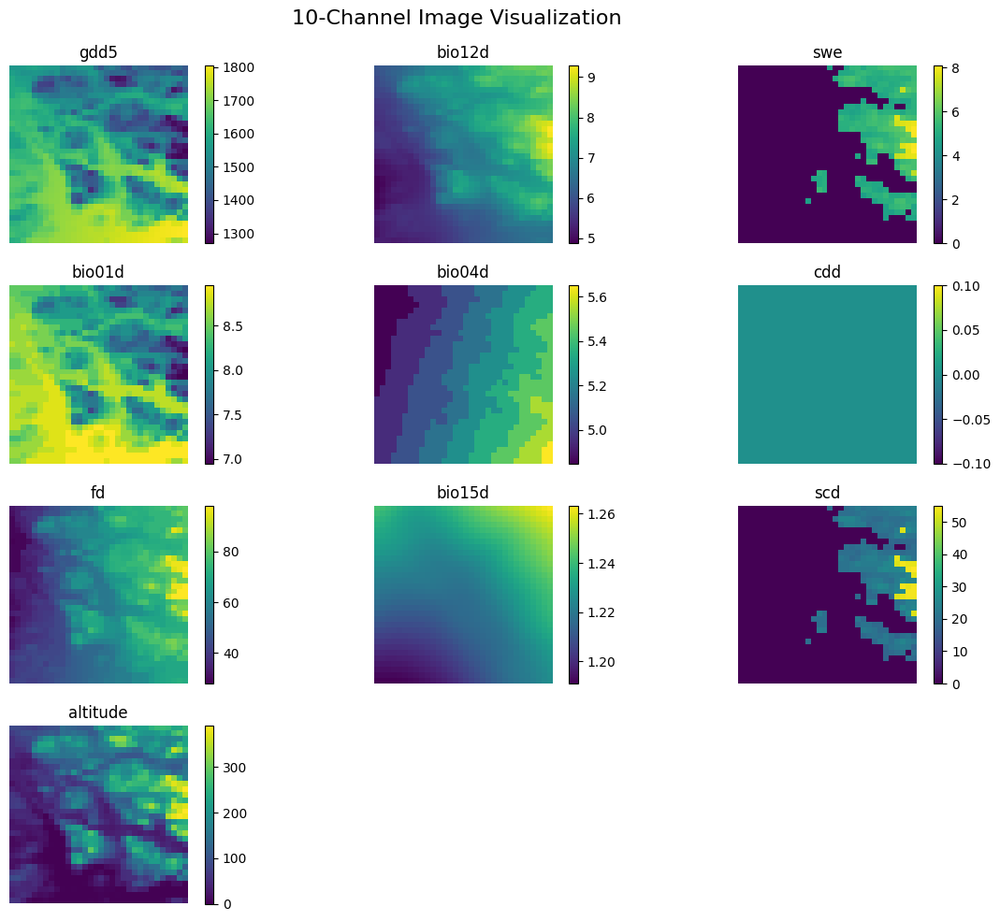

In [69]:
import numpy as np
import matplotlib.pyplot as plt

# Extract the 10-channel image
image_10ch = gbif_assemblages_climatic.iloc[3000].climatic_map  # Shape (H, W, 10)

# Set up a 4x3 grid to display all 10 channels with some space
fig, axes = plt.subplots(4, 3, figsize=(12, 10))
fig.suptitle("10-Channel Image Visualization", fontsize=16)

# Create a color map
cmap = plt.get_cmap("viridis")

# Variable names (avoid modifying the original 'variables' list)
variable_names = ['gdd5','bio12d', 'swe', 'bio01d', 'bio04d', 'cdd', 'fd', 'bio15d', 'scd','altitude']

# Plot each channel
for i in range(10):
    ax = axes[i // 3, i % 3]
    img = ax.imshow(image_10ch[:, :, i], cmap=cmap)
    ax.set_title(f"{variable_names[i]}")
    ax.axis("off")
    fig.colorbar(img, ax=ax, orientation='vertical')

# Hide unused subplots (positions 10 and 11 in a 4x3 grid)
for j in range(10, 12):
    axes[j // 3, j % 3].axis("off")

plt.tight_layout()
plt.subplots_adjust(top=0.92)  # Leave space for suptitle
plt.show()



#### Testing

In [26]:
import numpy as np
# Loop through the dictionary and replace NaN by 0 in each cube
for year, cube in climate_cubes_by_year.items():
    climate_cubes_by_year[year] = np.nan_to_num(cube, nan=0)

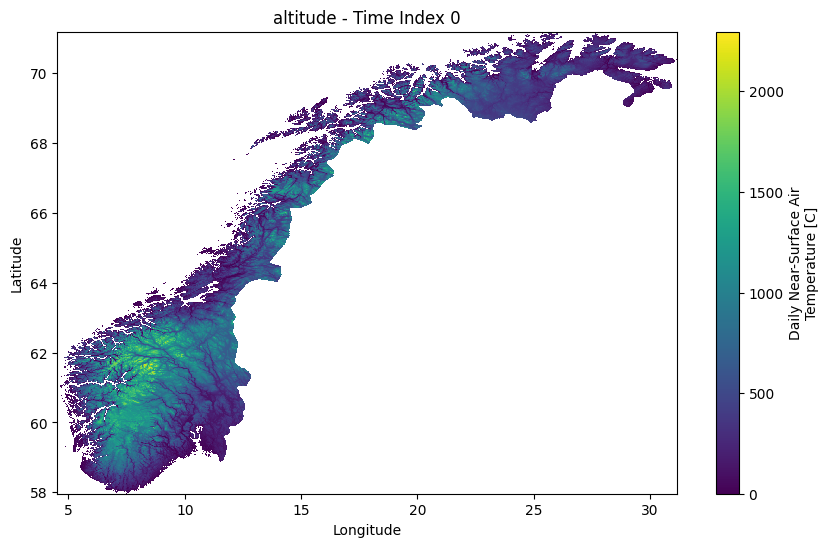

In [32]:
import matplotlib.pyplot as plt

# Extract one variable (e.g., 'gdd5') and select a time slice (e.g., first time point)
variable = "altitude"  # Change this to any variable in your dataset
time_index = 0  # Select a specific time index (0 for the first year, adjust as needed)

# Extract the data for the selected variable and time slice
data = norway_climate_cube.sel(variable=variable).isel(time=time_index)

# Plot the data (assuming the dimensions are latitude and longitude)
plt.figure(figsize=(10, 6))
data.plot()
plt.title(f"{variable} - Time Index {time_index}")
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()
